In [6]:
import numpy as np
import PIL
from PIL import Image
import numpy as np
import torch
import os

# Some more magic so that the notebook will reload external python modules;
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
def display_alongside_batch(img_list, resize_dims=(256,256)):
    res = np.concatenate([np.array(img.resize(resize_dims)) for img in img_list], axis=1)
    return Image.fromarray(res)

## 0. Image Generation using a Diffusion Model

In [3]:
from diffusers import DiffusionPipeline

device = torch.device('cuda:0') if torch.cuda.is_available() else torch.device('cpu')
pipeline = DiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4",torch_dtype=torch.float16)
_ = pipeline.to(device)

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Input Prompt: a penguin wearing a bowtie on a surfboard in a swimming pool


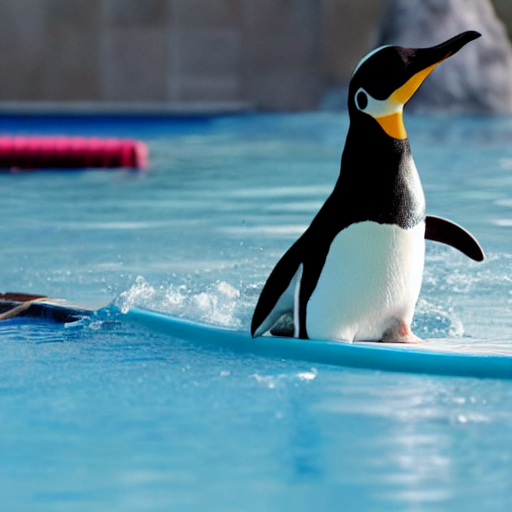

In [4]:
# generate image from prompt
prompt = "a penguin wearing a bowtie on a surfboard in a swimming pool"

generator = torch.manual_seed(0)
image = pipeline(prompt,num_images_per_prompt=1,width=512, height=512, generator=generator).images[0]

# display results
print ("Input Prompt:", prompt)
display(image)

<div class="alert alert-info">
<b>Note:</b> The generated image is clearly not a very good match for input prompt "a penguin wearing a bowtie on a surfboard in a swimming pool" as the
    penguin is not wearing a bowtie. 
</div>

## 1. DA-Score: Evaluating Text-to-Image Alignment

We next show the use of Decompositional Alignment Score (DA-Score) for accurate and interpretable evaluation of text-to-image alignment.

In [7]:
# Our code also relies on OpenAI API for parsing complex prompt inputs. Please enter the OPENAI-KEY here.
import openai
openai.api_key = "[Your OpenAI Key]"

In [8]:
# load modules and define vqa model
from t2i_eval.utils import generate_questions, VQAModel, compute_dascores
# create vqa_model
vqa_model = VQAModel()

In [9]:
# generate set of disjoint questions from the input prompt using LLM model
questions, parsed_input = generate_questions(prompt)


----------------------------------------------------------------------------------------------
Prompt: a penguin wearing a bowtie on a surfboard in a swimming pool
Prompt Decomposition (into subprompts): [a penguin] [wearing a bowtie] [on a surfboard] [in a swimming pool]

Questions and VQA based Alignment Scores (using BLIP-VQA):
#0: is there a penguin in the image?	 VQA-Score: 0.89
#1: is the penguin wearing a bowtie?	 VQA-Score: 0.02
#2: is the penguin on a surfboard?	 VQA-Score: 0.89
#3: is the surfboard in a swimming pool?	 VQA-Score: 0.88

Overall Text-to-Image Alignment Score (DA-Score): 0.67
----------------------------------------------------------------------------------------------



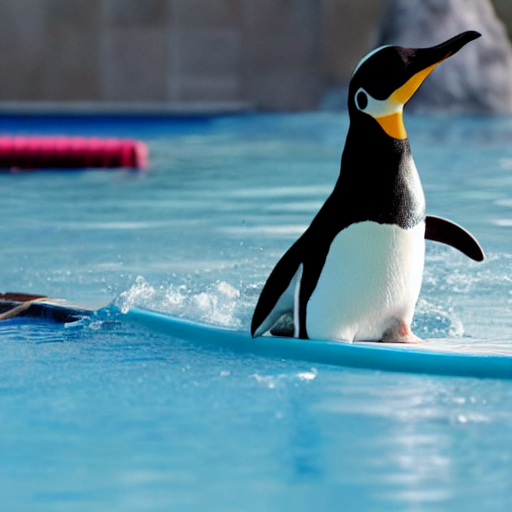

In [10]:
# compute DA-Score from the generated questions
da_score, assertion_alignment_scores = compute_dascores([image], questions, vqa_model)

# display results
print ('\n----------------------------------------------------------------------------------------------')
print ("Prompt: {}".format(prompt))
print ("Prompt Decomposition (into subprompts): {}\n".format(parsed_input['decomposable_prompt']))
print ("Questions and VQA based Alignment Scores (using BLIP-VQA):")
for idx in range(len(questions)):
    print ("#{}: {}\t VQA-Score: {:.2f}".format(idx, questions[idx], assertion_alignment_scores[0][idx]))
print ("\nOverall Text-to-Image Alignment Score (DA-Score): {:.2f}".format(da_score[0]))
print ('----------------------------------------------------------------------------------------------\n')
display(image)

<div class="alert alert-info">
<b>Note:</b> Decompositional Alignment Score (DA-Score) provides an accurate and interpretable approach for evaluating T2I alignment. We not only can see that the final image is not a good match for the prompt, but can also see why. (low VQA-score for "Q2: is penguin is wearing a bowtie?")
</div>

## 2. Improving Text to Image Aligment Using Iterative Feedback

Assertion/Question level alignment scores also provide a useful feedback to determine which parts of the input prompt are not being expressed in the final image generation. Eval&Refine uses this knowledge in order to propose a very simple yet effective iterative refinement process which gradually improves the quality of the final image outputs.

In [11]:
from t2i_improve.pipeline_evaluate_and_refine import StableDiffusionEvaluatendRefinePipeline

# load the Eval&Refine Pipeline
model_id = "CompVis/stable-diffusion-v1-4"
pipe = StableDiffusionEvaluatendRefinePipeline.from_pretrained(model_id, torch_dtype=torch.float16)
pipe = pipe.to("cuda:1")

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

In [12]:
# generate the questions and parsed_input from the input prompt using LLM model
questions, parsed_input = generate_questions(prompt)

---
Eval&Refine is provided as a convenient Diffusers pipeline and can be invoked using a simple pipeline call.

We provide two mechanisms for iterative refinement with Eval&Refine: 

1. Prompt-Weighting (PW), &
2. Cross-Attention modulation (CA).

Below we show how iterative refinment with prompt-weighting alone helps achieve better T2I alignment results.

---

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

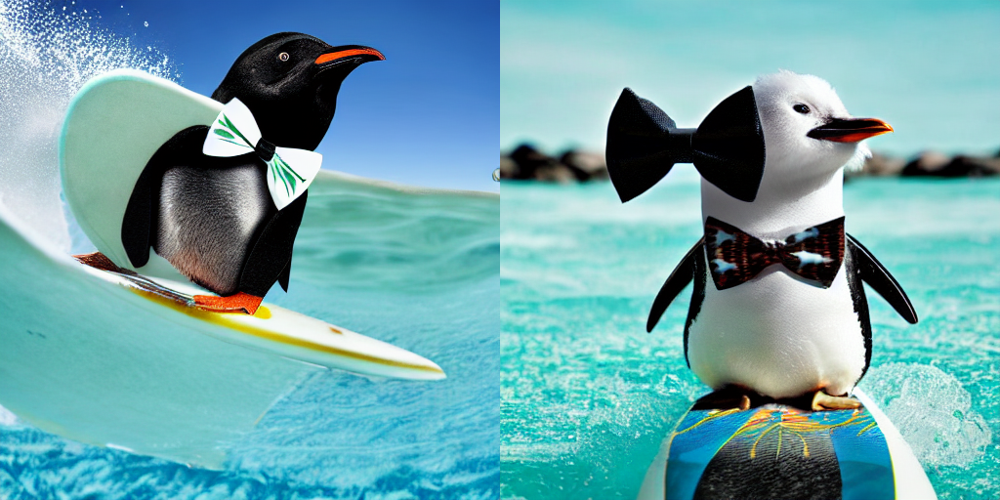

In [13]:
# perform inference using iterative refinement
outputs = pipe.eval_and_refine(parsed_input, vqa_model, use_pw=True, use_ca=False, seed_list=[77,402], max_update_steps=5, verbose=False)
display(display_alongside_batch(outputs,resize_dims=(512,512)))

---
We can also visualize working of the iterative refinement process by using `verbose=True`

---


----------------------------------------------------------------------------------------------
Prompt: a penguin wearing a bowtie on a surfboard in a swimming pool
Decomposable Prompt: [a penguin] [wearing a bowtie] [on a surfboard] [in a swimming pool]

Set of Disjoint Questions:
#0: is there a penguin in the image?
#1: is the penguin wearing a bowtie?
#2: is the penguin on a surfboard?
#3: is the surfboard in a swimming pool?

Key Entities (used for CA-control in Eval&Refine and computing token-indices for baseline Attend&Excite)
Subprompt: a penguin	 Entity: penguin
Subprompt: wearing a bowtie	 Entity: bowtie
Subprompt: on a surfboard	 Entity: surfboard
Subprompt: in a swimming pool	 Entity: pool
----------------------------------------------------------------------------------------------


Iterative refinement step: 1 ...
Using prompt-weighting update weights:	[1. 1. 1. 1.]
Using cross-attention update weights:	[0. 0. 0. 0.]


  0%|          | 0/50 [00:00<?, ?it/s]

Using prompt-weighting update weights:	[1. 1. 1. 1.]
Using cross-attention update weights:	[0. 0. 0. 0.]


  0%|          | 0/50 [00:00<?, ?it/s]


----------------------------------------------------------------------------------------------
Image #0	Done: False	DA-Score: 0.59	Assertion-Alignment-Scores: ['0.88', '0.88', '0.17', '0.42']
Image #1	Done: False	DA-Score: 0.63	Assertion-Alignment-Scores: ['0.88', '0.02', '0.80', '0.81']

Best Outputs after Refinement Step: 0/5	 DA-Scores: ['0.59', '0.63']


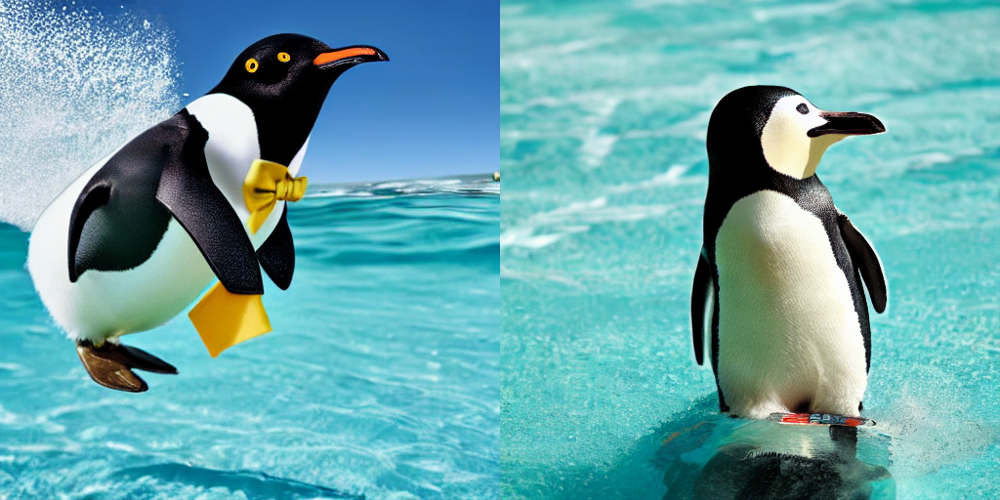

----------------------------------------------------------------------------------------------


Iterative refinement step: 2 ...
Using prompt-weighting update weights:	[1 1 2 1]
Using cross-attention update weights:	[0. 0. 0. 0.]


  0%|          | 0/50 [00:00<?, ?it/s]

Using prompt-weighting update weights:	[1 2 1 1]
Using cross-attention update weights:	[0. 0. 0. 0.]


  0%|          | 0/50 [00:00<?, ?it/s]


----------------------------------------------------------------------------------------------
Image #0	Done: False	DA-Score: 0.63	Assertion-Alignment-Scores: ['0.87', '0.05', '0.84', '0.75']
Image #1	Done: False	DA-Score: 0.60	Assertion-Alignment-Scores: ['0.88', '0.89', '0.07', '0.57']

Best Outputs after Refinement Step: 1/5	 DA-Scores: ['0.63', '0.63']


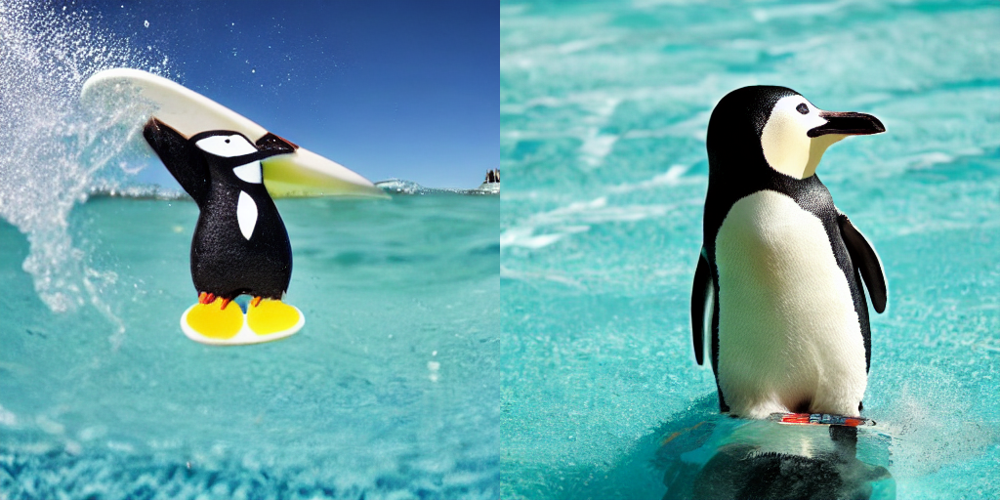

----------------------------------------------------------------------------------------------


Iterative refinement step: 3 ...
Using prompt-weighting update weights:	[1 2 2 1]
Using cross-attention update weights:	[0. 0. 0. 0.]


  0%|          | 0/50 [00:00<?, ?it/s]

Using prompt-weighting update weights:	[1 2 2 1]
Using cross-attention update weights:	[0. 0. 0. 0.]


  0%|          | 0/50 [00:00<?, ?it/s]


----------------------------------------------------------------------------------------------
Image #0	Done: True	DA-Score: 0.86	Assertion-Alignment-Scores: ['0.89', '0.89', '0.90', '0.74']
Image #1	Done: True	DA-Score: 0.87	Assertion-Alignment-Scores: ['0.89', '0.89', '0.88', '0.81']

Best Outputs after Refinement Step: 2/5	 DA-Scores: ['0.86', '0.87']


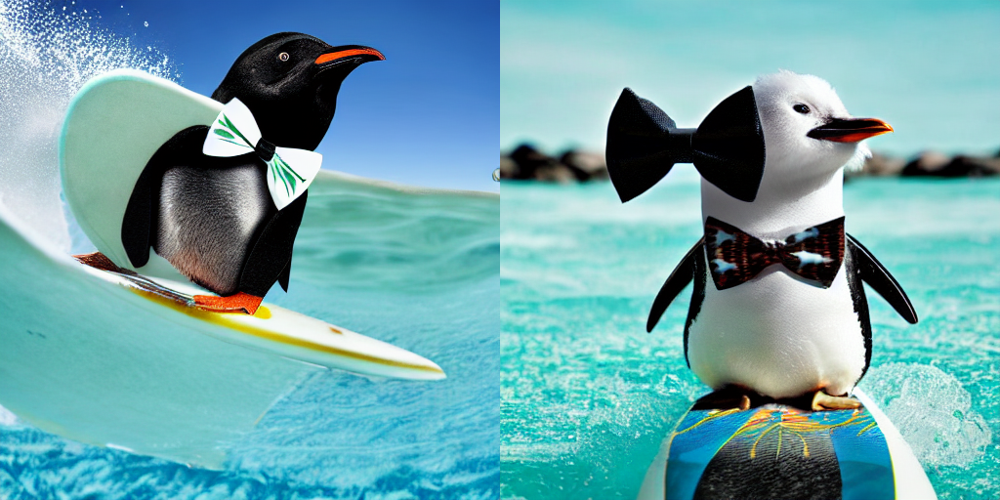

----------------------------------------------------------------------------------------------



In [14]:
# perform inference using iterative refinement
outputs = pipe.eval_and_refine(parsed_input, vqa_model, use_pw=True, use_ca=False, seed_list=[77,402], max_update_steps=5, verbose=True)

## 3. Comparisons with Attend and Excite

We analyse 3 main ways in which Eval&Refine improves over previous state-of-the-art Attend&Excite

#### Example 1: Missing Relationship

**Missing Relationship**: We notice that while Attend&Excite depicts both lion and guitar in the output images, the lion does not appear to be playing the guitar. Evaluate&Refine helps better capture both presence and relationship between the objects.

In [15]:
# define input prompt and generate questions/assertions using LLM
prompt = 'a lion playing guitar'
questions, parsed_input = generate_questions(prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

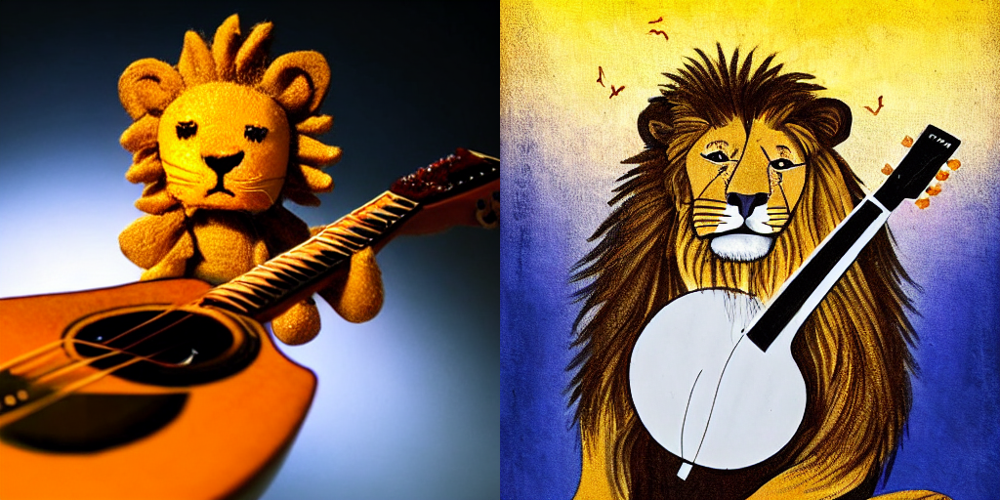

In [17]:
# generate baseline Attend&Excite results
out_attend_and_excite = pipe.attend_and_excite(prompt, entities= parsed_input['entities'], seed_list=[21,22])
display(display_alongside_batch(out_attend_and_excite,resize_dims=(512,512)))


----------------------------------------------------------------------------------------------
Prompt: a lion playing guitar
Decomposable Prompt: [a lion] [playing guitar]

Set of Disjoint Questions:
#0: is there a lion in the image?
#1: is the lion playing a guitar?

Key Entities (used for CA-control in Eval&Refine and computing token-indices for baseline Attend&Excite)
Subprompt: a lion	 Entity: lion
Subprompt: playing guitar	 Entity: guitar
----------------------------------------------------------------------------------------------


Iterative refinement step: 1 ...
Using prompt-weighting update weights:	[1. 1.]
Using cross-attention update weights:	[0. 0.]


  0%|          | 0/50 [00:00<?, ?it/s]

Using prompt-weighting update weights:	[1. 1.]
Using cross-attention update weights:	[0. 0.]


  0%|          | 0/50 [00:00<?, ?it/s]


----------------------------------------------------------------------------------------------
Image #0	Done: False	DA-Score: 0.44	Assertion-Alignment-Scores: ['0.89', '0.00']
Image #1	Done: False	DA-Score: 0.61	Assertion-Alignment-Scores: ['0.85', '0.37']

Best Outputs after Refinement Step: 0/5	 DA-Scores: ['0.44', '0.61']


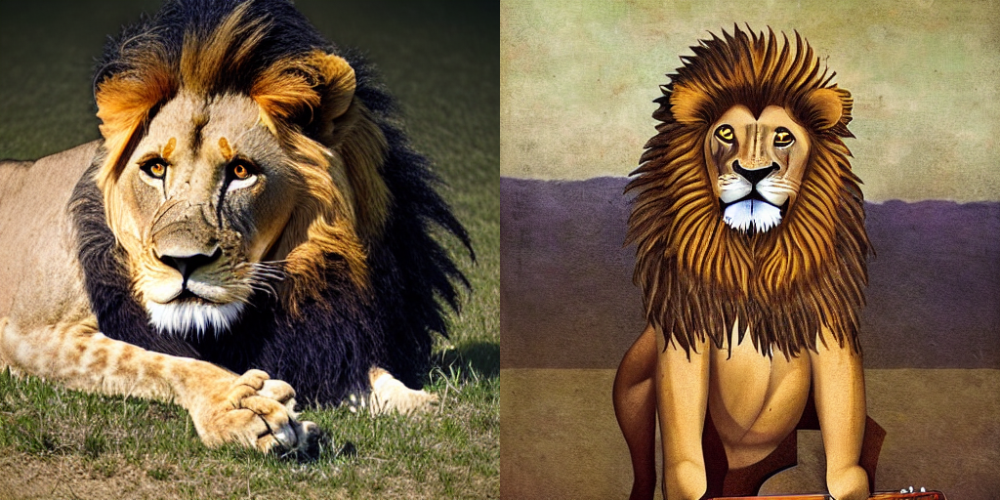

----------------------------------------------------------------------------------------------


Iterative refinement step: 2 ...
Using prompt-weighting update weights:	[1 2]
Using cross-attention update weights:	[0. 1.]


  0%|          | 0/50 [00:00<?, ?it/s]

Using prompt-weighting update weights:	[1 2]
Using cross-attention update weights:	[0. 1.]


  0%|          | 0/50 [00:00<?, ?it/s]


----------------------------------------------------------------------------------------------
Image #0	Done: True	DA-Score: 0.86	Assertion-Alignment-Scores: ['0.88', '0.84']
Image #1	Done: True	DA-Score: 0.84	Assertion-Alignment-Scores: ['0.85', '0.83']

Best Outputs after Refinement Step: 1/5	 DA-Scores: ['0.86', '0.84']


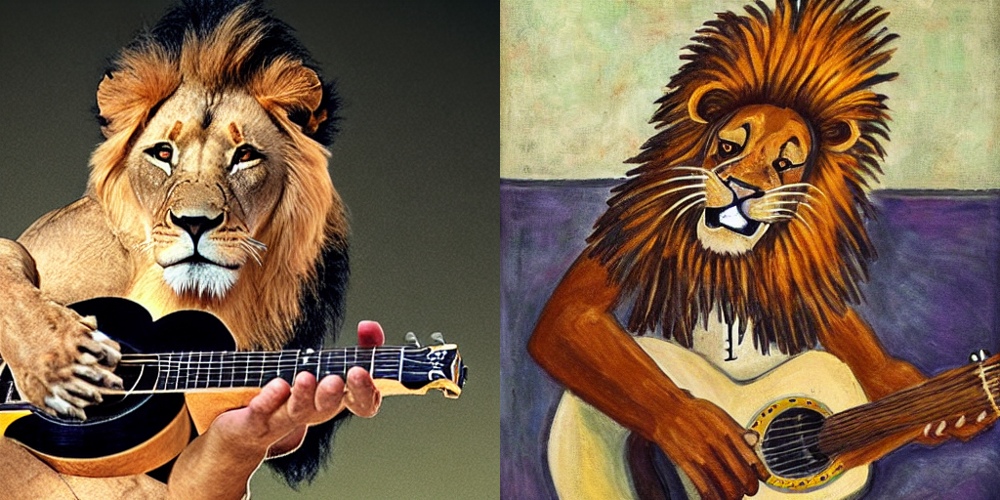

----------------------------------------------------------------------------------------------



In [18]:
# generate results using Eval&Refine with same seed
out_eval_and_refine = pipe.eval_and_refine(parsed_input, vqa_model, use_pw=True, use_ca=True, seed_list=[21,22], max_update_steps=5, verbose=True)


----------------------------------------------------------------------------------------------
Input prompt:  a lion playing guitar
----------------------------------------------------------------------------------------------

With Attend&Excite:


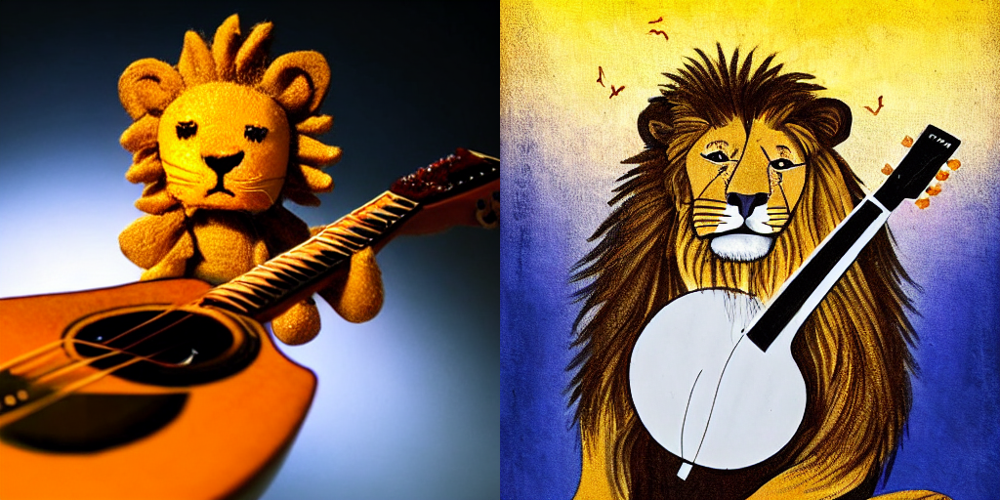

----------------------------------------------------------------------------------------------

With Evaluate&Refine:


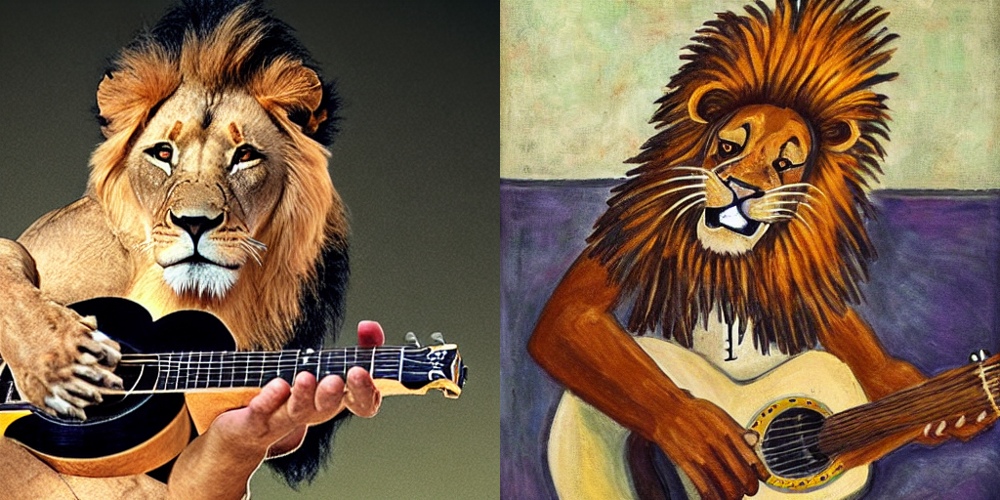

In [19]:
# final comparison
print ('\n----------------------------------------------------------------------------------------------')
print ("Input prompt: ", prompt)
print ('----------------------------------------------------------------------------------------------\n')

print ('With Attend&Excite:')
display(display_alongside_batch(out_attend_and_excite,resize_dims=(512,512)))

print ('----------------------------------------------------------------------------------------------\n')
print ('With Evaluate&Refine:')
display(display_alongside_batch(out_eval_and_refine,resize_dims=(512,512)))

<div class="alert alert-info">
<b>Missing Relationship:</b> We note that while attend and excite helps depict both lion and guitar in the output images, the lion does not appear to be playing the guitar. 
Evaluate&Refine helps better capture both presence and relationship between the objects.

#### Example 2: Overlapping Entities

**Overlapping Entities**: For images with overlapping entities (e.g., person and scubasuit), we observe that Attend-and-Excite  typicallyspends most of gradient updates balancing between the overlapping entities, as both entities (person and scubasuit) occupy the same cross-attention region. This can lead to outputs where other important aspects (e.g., cello) are ignored.

In [22]:
# define input prompt and generate questions
prompt = 'a man wearing scuba suit playing cello underwater'
questions, parsed_input = generate_questions(prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

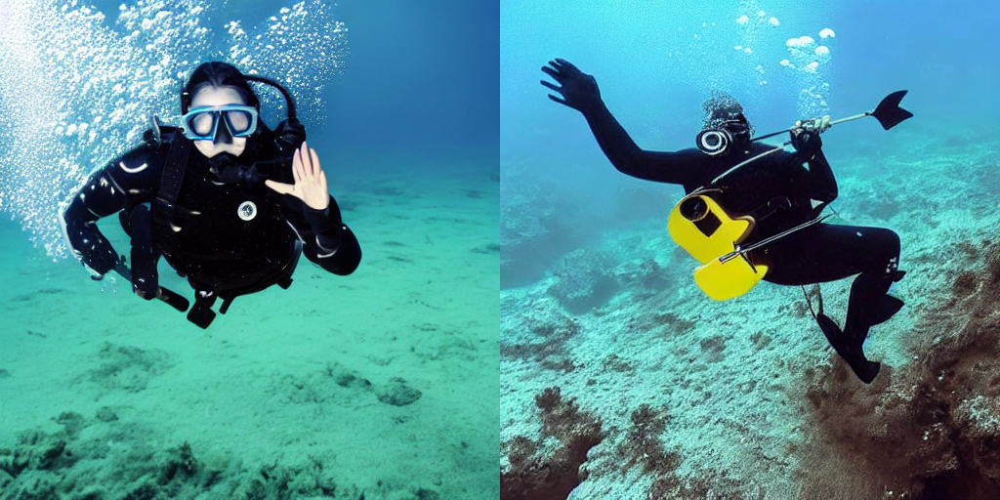

In [23]:
# generate baseline Attend&Excite results
out_attend_and_excite = pipe.attend_and_excite(prompt, entities= parsed_input['entities'], seed_list=[77,78])
display(display_alongside_batch(out_attend_and_excite,resize_dims=(512,512)))


----------------------------------------------------------------------------------------------
Prompt: a man wearing scuba suit playing cello underwater
Decomposable Prompt: [a man] [wearing scuba suit] [playing cello] [underwater]

Set of Disjoint Questions:
#0: is there a man in the image?
#1: is the man wearing a scuba suit?
#2: is the man playing a cello?
#3: is the man underwater?

Key Entities (used for CA-control in Eval&Refine and computing token-indices for baseline Attend&Excite)
Subprompt: a man	 Entity: man
Subprompt: wearing scuba suit	 Entity: suit
Subprompt: playing cello	 Entity: cello
Subprompt: underwater	 Entity: underwater
----------------------------------------------------------------------------------------------


Iterative refinement step: 1 ...
Using prompt-weighting update weights:	[1. 1. 1. 1.]
Using cross-attention update weights:	[0. 0. 0. 0.]


  0%|          | 0/50 [00:00<?, ?it/s]

Using prompt-weighting update weights:	[1. 1. 1. 1.]
Using cross-attention update weights:	[0. 0. 0. 0.]


  0%|          | 0/50 [00:00<?, ?it/s]


----------------------------------------------------------------------------------------------
Image #0	Done: False	DA-Score: 0.65	Assertion-Alignment-Scores: ['0.81', '0.89', '0.01', '0.89']
Image #1	Done: False	DA-Score: 0.74	Assertion-Alignment-Scores: ['0.84', '0.88', '0.35', '0.88']

Best Outputs after Refinement Step: 0/5	 DA-Scores: ['0.65', '0.74']


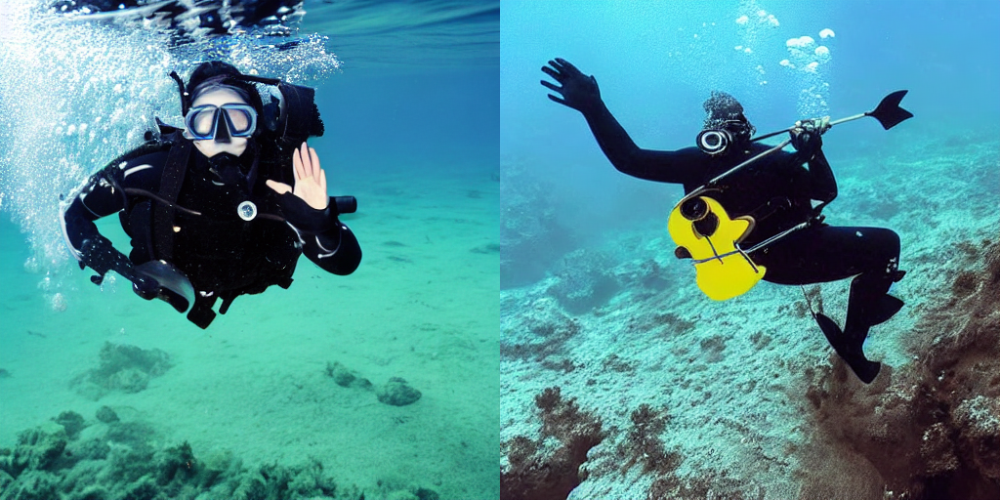

----------------------------------------------------------------------------------------------


Iterative refinement step: 2 ...
Using prompt-weighting update weights:	[1 1 2 1]
Using cross-attention update weights:	[0. 0. 1. 0.]


  0%|          | 0/50 [00:00<?, ?it/s]

Using prompt-weighting update weights:	[1 1 2 1]
Using cross-attention update weights:	[0. 0. 1. 0.]


  0%|          | 0/50 [00:00<?, ?it/s]


----------------------------------------------------------------------------------------------
Image #0	Done: False	DA-Score: 0.66	Assertion-Alignment-Scores: ['0.84', '0.89', '0.01', '0.89']
Image #1	Done: False	DA-Score: 0.82	Assertion-Alignment-Scores: ['0.88', '0.88', '0.64', '0.85']

Best Outputs after Refinement Step: 1/5	 DA-Scores: ['0.66', '0.82']


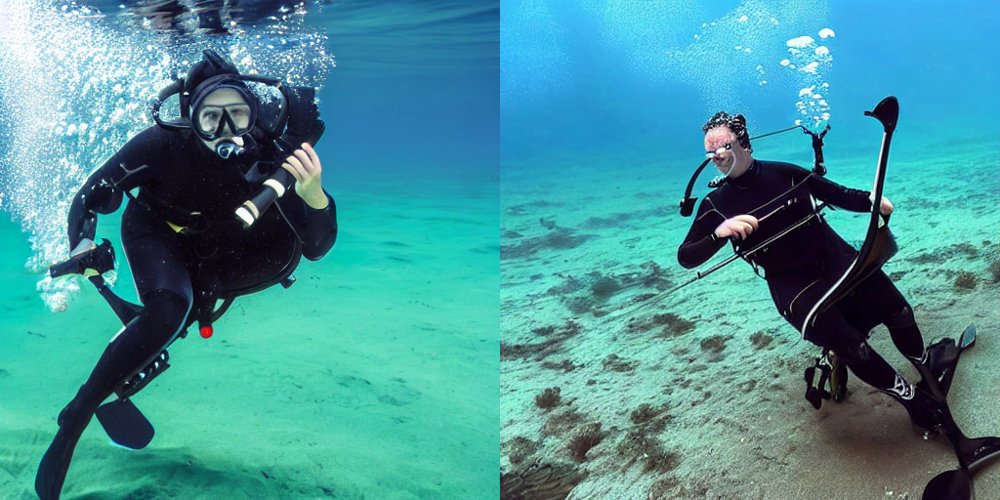

----------------------------------------------------------------------------------------------


Iterative refinement step: 3 ...
Using prompt-weighting update weights:	[1 1 3 1]
Using cross-attention update weights:	[0. 0. 2. 0.]


  0%|          | 0/50 [00:00<?, ?it/s]

Using prompt-weighting update weights:	[1 1 3 1]
Using cross-attention update weights:	[0. 0. 2. 0.]


  0%|          | 0/50 [00:00<?, ?it/s]


----------------------------------------------------------------------------------------------
Image #0	Done: False	DA-Score: 0.78	Assertion-Alignment-Scores: ['0.86', '0.88', '0.56', '0.82']
Image #1	Done: True	DA-Score: 0.86	Assertion-Alignment-Scores: ['0.85', '0.88', '0.82', '0.87']

Best Outputs after Refinement Step: 2/5	 DA-Scores: ['0.78', '0.86']


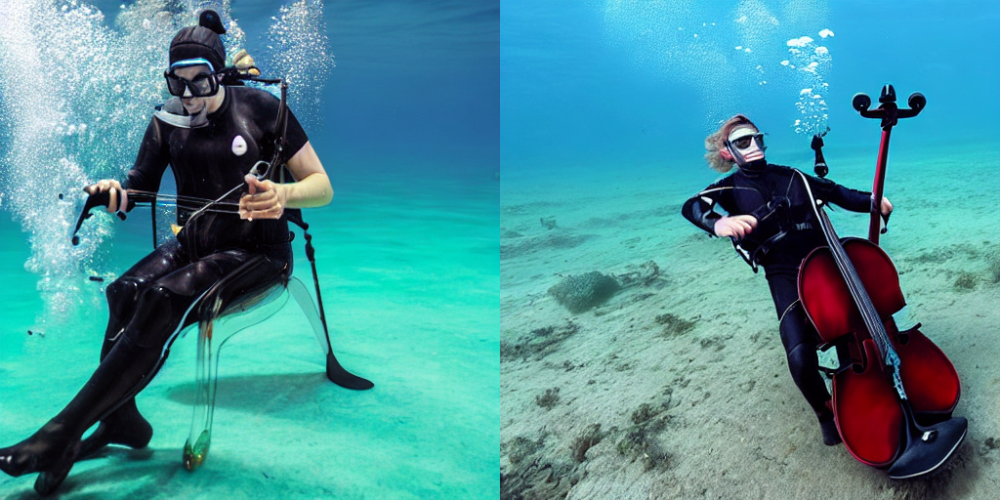

----------------------------------------------------------------------------------------------


Iterative refinement step: 4 ...
Using prompt-weighting update weights:	[1 1 4 1]
Using cross-attention update weights:	[0. 0. 3. 0.]


  0%|          | 0/50 [00:00<?, ?it/s]


----------------------------------------------------------------------------------------------
Image #0	Done: True	DA-Score: 0.88	Assertion-Alignment-Scores: ['0.87', '0.89', '0.88', '0.86']
Image #1	Done: True	DA-Score: 0.86	Assertion-Alignment-Scores: ['0.85', '0.88', '0.82', '0.87']

Best Outputs after Refinement Step: 3/5	 DA-Scores: ['0.88', '0.86']


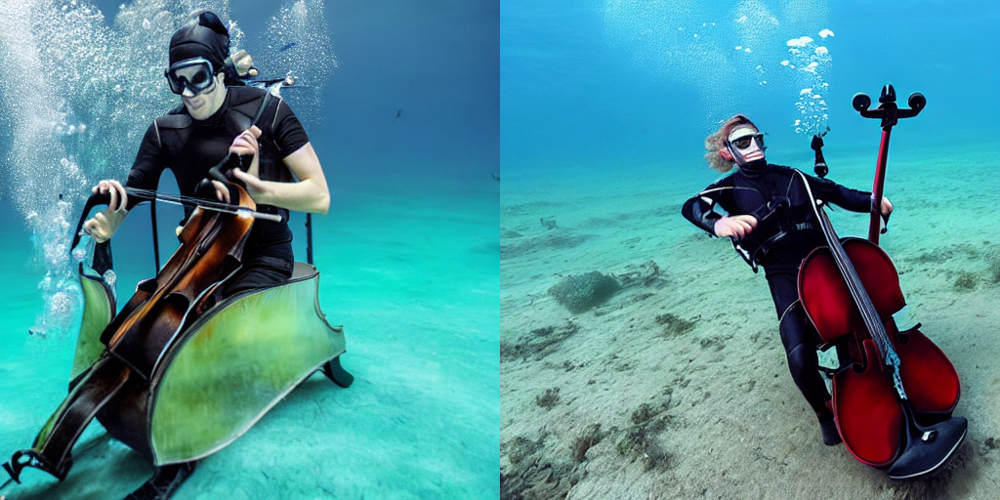

----------------------------------------------------------------------------------------------



In [24]:
# generate results using Eval&Refine with same seed
out_eval_and_refine = pipe.eval_and_refine(parsed_input, vqa_model, use_pw=True, use_ca=True, seed_list=[77,78], max_update_steps=5, verbose=True)


----------------------------------------------------------------------------------------------
Input prompt:  a man wearing scuba suit playing cello underwater
----------------------------------------------------------------------------------------------

With Attend&Excite:


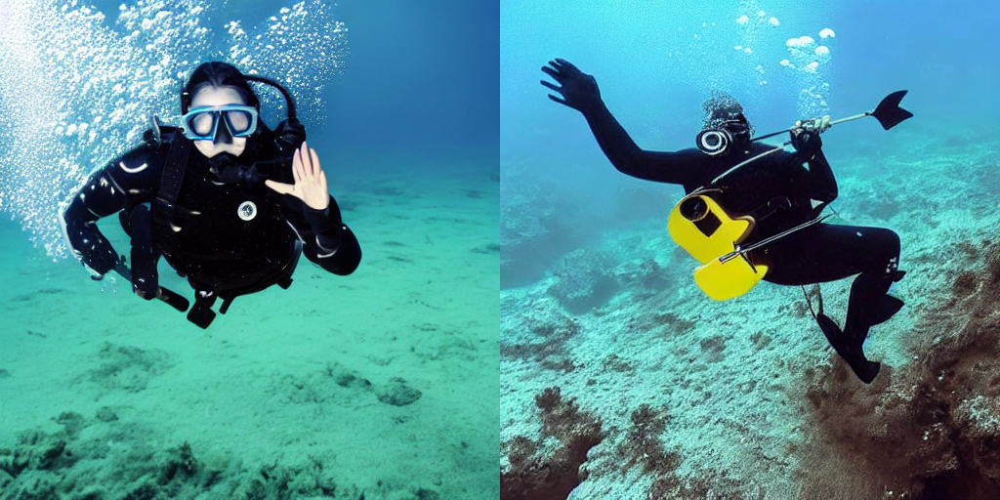

----------------------------------------------------------------------------------------------

With Evaluate&Refine:


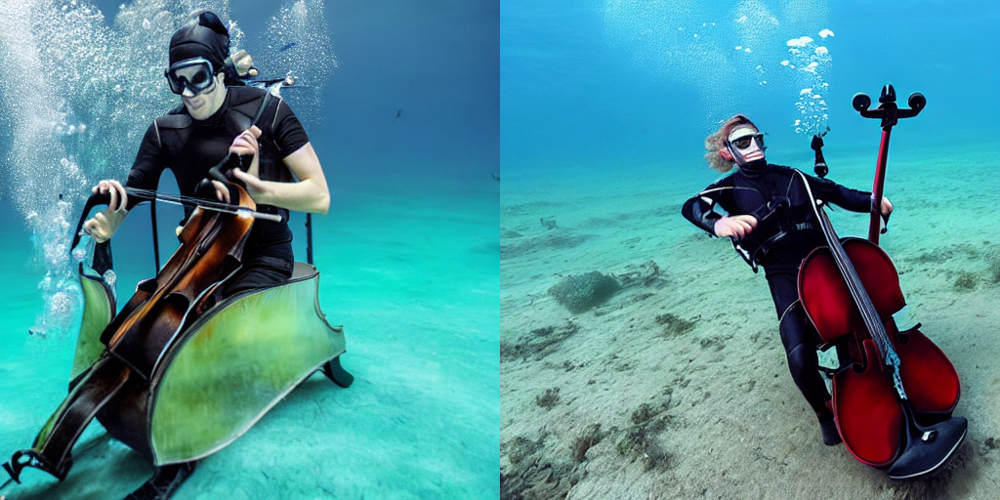

In [25]:
# final comparison
print ('\n----------------------------------------------------------------------------------------------')
print ("Input prompt: ", prompt)
print ('----------------------------------------------------------------------------------------------\n')

print ('With Attend&Excite:')
display(display_alongside_batch(out_attend_and_excite,resize_dims=(512,512)))

print ('----------------------------------------------------------------------------------------------\n')
print ('With Evaluate&Refine:')
display(display_alongside_batch(out_eval_and_refine,resize_dims=(512,512)))

<div class="alert alert-info">
<b>Overlapping Entities:</b> For images with overlapping entities (e.g., person and scubasuit), we observe that Attend-and-Excite  typically
spends most of gradient updates balancing between the overlapping entities, as both entities (person and scubasuit) occupy the same cross-attention region. This can lead to outputs where other important aspects (e.g., cello) are ignored.

#### Example 3: Missing objects

**Missing Objects** Since Attend-and-Excite is limited to applying the cross-attention update w.r.t the least dominant subject, as the complexityof input prompt increases, it may miss some objects (e.g., umbrella) during the generation process. 
In contrast, the iterative nature of our approach allows it to keep refining the output image until a desirable threhold for the overall image-text alignment score is reached.

In [26]:
# define input prompt and generate questions
prompt = 'a snowman wearing sunglasses holding an umbrella at beach on a sunny day'
questions, parsed_input = generate_questions(prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

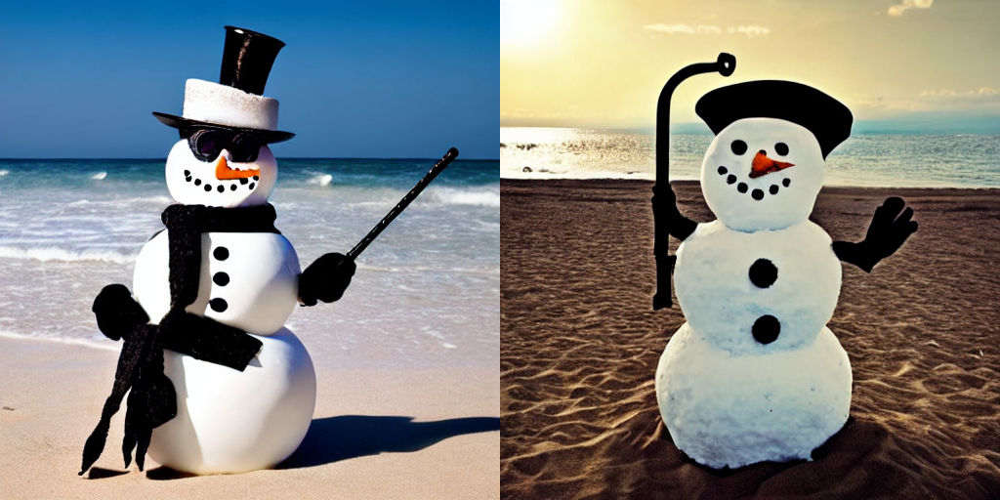

In [27]:
# generate baseline Attend&Excite results
out_attend_and_excite = pipe.attend_and_excite(prompt, entities= parsed_input['entities'], seed_list=[21,22])
display(display_alongside_batch(out_attend_and_excite,resize_dims=(512,512)))


----------------------------------------------------------------------------------------------
Prompt: a snowman wearing sunglasses holding an umbrella at beach on a sunny day
Decomposable Prompt: [a snowman] [wearing sunglasses] [holding an umbrella] [at beach] [on a sunny day]

Set of Disjoint Questions:
#0: is there a snowman in the image?
#1: is the snowman wearing sunglasses?
#2: is the snowman holding an umbrella?
#3: is the snowman at the beach?
#4: is it a sunny day in the image?

Key Entities (used for CA-control in Eval&Refine and computing token-indices for baseline Attend&Excite)
Subprompt: a snowman	 Entity: snowman
Subprompt: wearing sunglasses	 Entity: sunglasses
Subprompt: holding an umbrella	 Entity: umbrella
Subprompt: at beach	 Entity: beach
Subprompt: on a sunny day	 Entity: day
----------------------------------------------------------------------------------------------


Iterative refinement step: 1 ...
Using prompt-weighting update weights:	[1. 1. 1. 1. 1.]
Usi

  0%|          | 0/50 [00:00<?, ?it/s]

Using prompt-weighting update weights:	[1. 1. 1. 1. 1.]
Using cross-attention update weights:	[0. 0. 0. 0. 0.]


  0%|          | 0/50 [00:00<?, ?it/s]


----------------------------------------------------------------------------------------------
Image #0	Done: False	DA-Score: 0.60	Assertion-Alignment-Scores: ['0.89', '0.25', '0.05', '0.90', '0.89']
Image #1	Done: False	DA-Score: 0.50	Assertion-Alignment-Scores: ['0.88', '0.08', '0.09', '0.89', '0.54']

Best Outputs after Refinement Step: 0/5	 DA-Scores: ['0.60', '0.50']


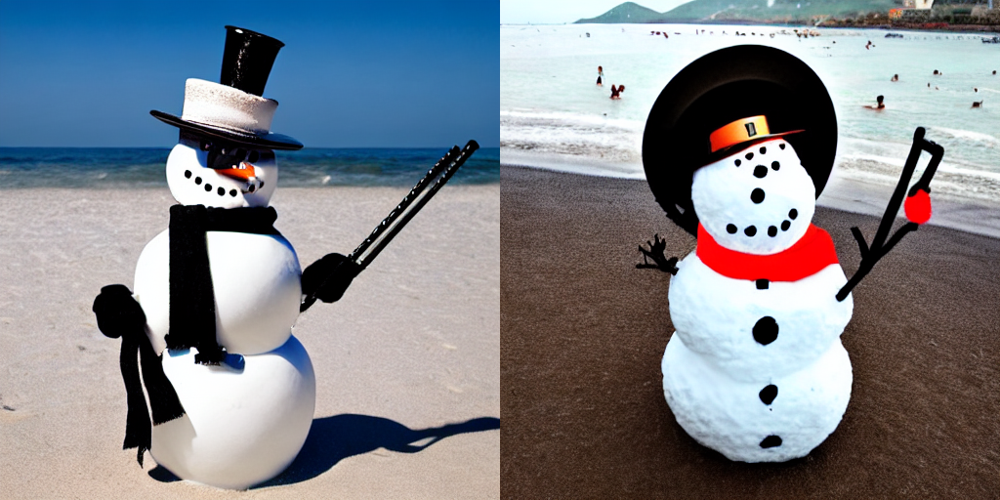

----------------------------------------------------------------------------------------------


Iterative refinement step: 2 ...
Using prompt-weighting update weights:	[1 2 1 1 1]
Using cross-attention update weights:	[0. 1. 0. 0. 0.]


  0%|          | 0/50 [00:00<?, ?it/s]

Using prompt-weighting update weights:	[1 2 1 1 1]
Using cross-attention update weights:	[0. 1. 0. 0. 0.]


  0%|          | 0/50 [00:00<?, ?it/s]


----------------------------------------------------------------------------------------------
Image #0	Done: False	DA-Score: 0.75	Assertion-Alignment-Scores: ['0.89', '0.89', '0.20', '0.90', '0.89']
Image #1	Done: False	DA-Score: 0.69	Assertion-Alignment-Scores: ['0.88', '0.87', '0.62', '0.89', '0.21']

Best Outputs after Refinement Step: 1/5	 DA-Scores: ['0.75', '0.69']


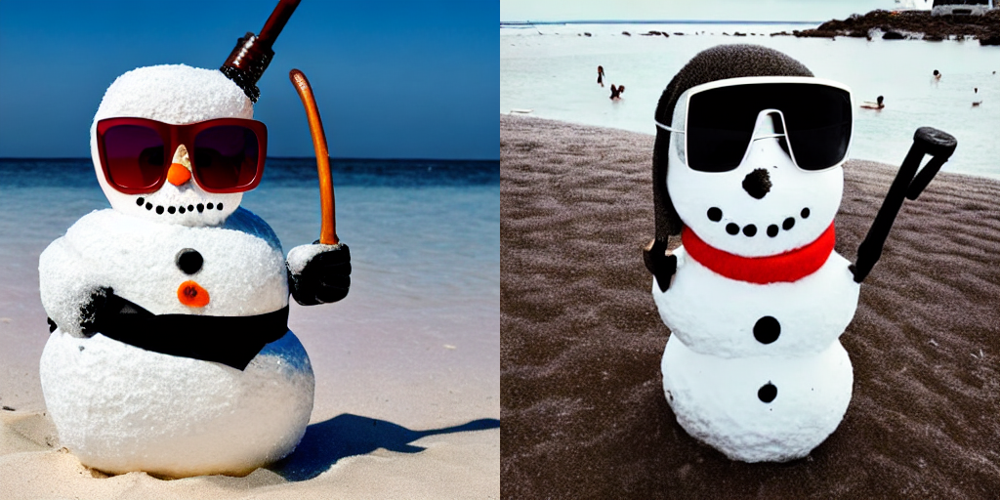

----------------------------------------------------------------------------------------------


Iterative refinement step: 3 ...
Using prompt-weighting update weights:	[1 2 2 1 1]
Using cross-attention update weights:	[0. 1. 1. 0. 0.]


  0%|          | 0/50 [00:00<?, ?it/s]

Using prompt-weighting update weights:	[1 2 2 1 1]
Using cross-attention update weights:	[0. 1. 1. 0. 0.]


  0%|          | 0/50 [00:00<?, ?it/s]


----------------------------------------------------------------------------------------------
Image #0	Done: True	DA-Score: 0.87	Assertion-Alignment-Scores: ['0.90', '0.87', '0.80', '0.90', '0.89']
Image #1	Done: False	DA-Score: 0.77	Assertion-Alignment-Scores: ['0.89', '0.89', '0.85', '0.90', '0.34']

Best Outputs after Refinement Step: 2/5	 DA-Scores: ['0.87', '0.77']


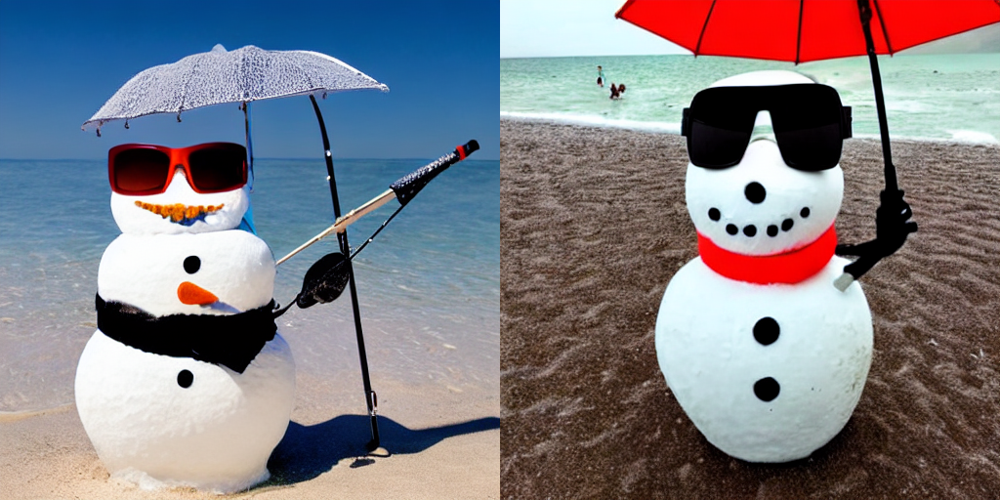

----------------------------------------------------------------------------------------------


Iterative refinement step: 4 ...
Using prompt-weighting update weights:	[1 2 2 1 2]
Using cross-attention update weights:	[0. 1. 1. 0. 1.]


  0%|          | 0/50 [00:00<?, ?it/s]


----------------------------------------------------------------------------------------------
Image #0	Done: True	DA-Score: 0.87	Assertion-Alignment-Scores: ['0.90', '0.87', '0.80', '0.90', '0.89']
Image #1	Done: False	DA-Score: 0.79	Assertion-Alignment-Scores: ['0.89', '0.89', '0.85', '0.90', '0.40']

Best Outputs after Refinement Step: 3/5	 DA-Scores: ['0.87', '0.79']


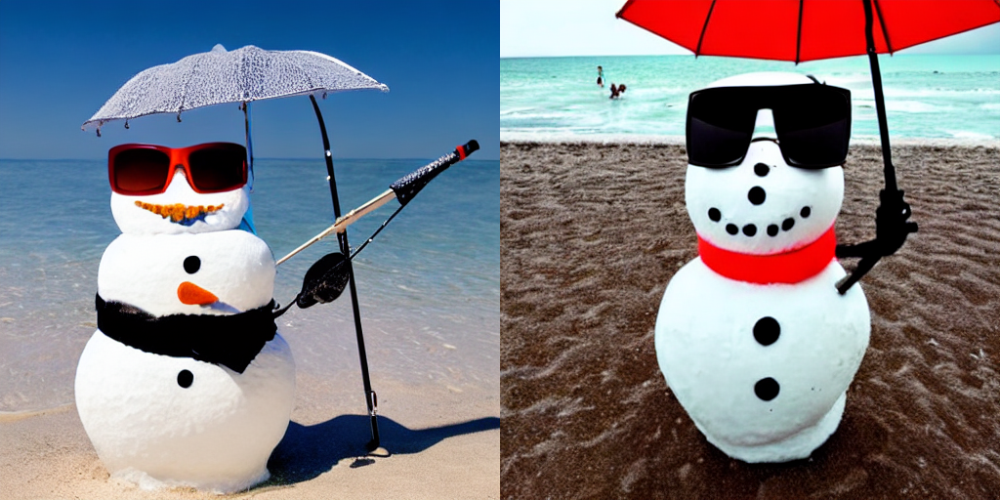

----------------------------------------------------------------------------------------------


Iterative refinement step: 5 ...
Using prompt-weighting update weights:	[1 2 2 1 3]
Using cross-attention update weights:	[0. 1. 1. 0. 2.]


  0%|          | 0/50 [00:00<?, ?it/s]


----------------------------------------------------------------------------------------------
Image #0	Done: True	DA-Score: 0.87	Assertion-Alignment-Scores: ['0.90', '0.87', '0.80', '0.90', '0.89']
Image #1	Done: False	DA-Score: 0.81	Assertion-Alignment-Scores: ['0.89', '0.89', '0.86', '0.90', '0.51']

Best Outputs after Refinement Step: 4/5	 DA-Scores: ['0.87', '0.81']


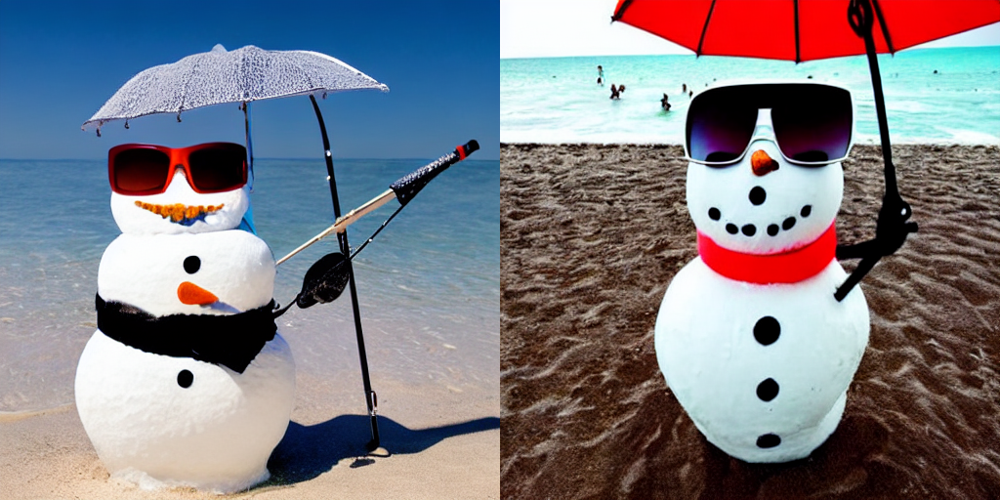

----------------------------------------------------------------------------------------------



In [28]:
# generate results using Eval&Refine with same seed
out_eval_and_refine = pipe.eval_and_refine(parsed_input, vqa_model, use_pw=True, use_ca=True, seed_list=[21,22], max_update_steps=5, verbose=True)


----------------------------------------------------------------------------------------------
Input prompt:  a snowman wearing sunglasses holding an umbrella at beach on a sunny day
----------------------------------------------------------------------------------------------

With Attend&Excite:


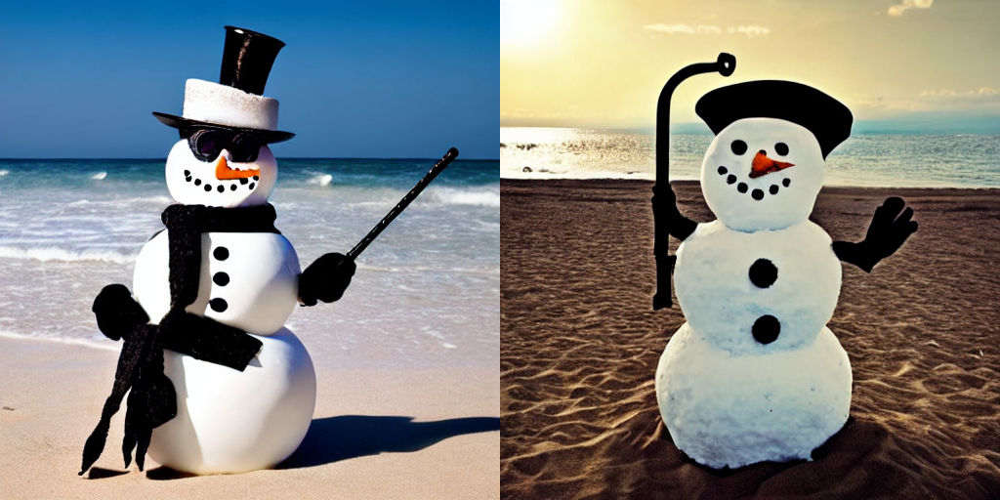

----------------------------------------------------------------------------------------------

With Evaluate&Refine:


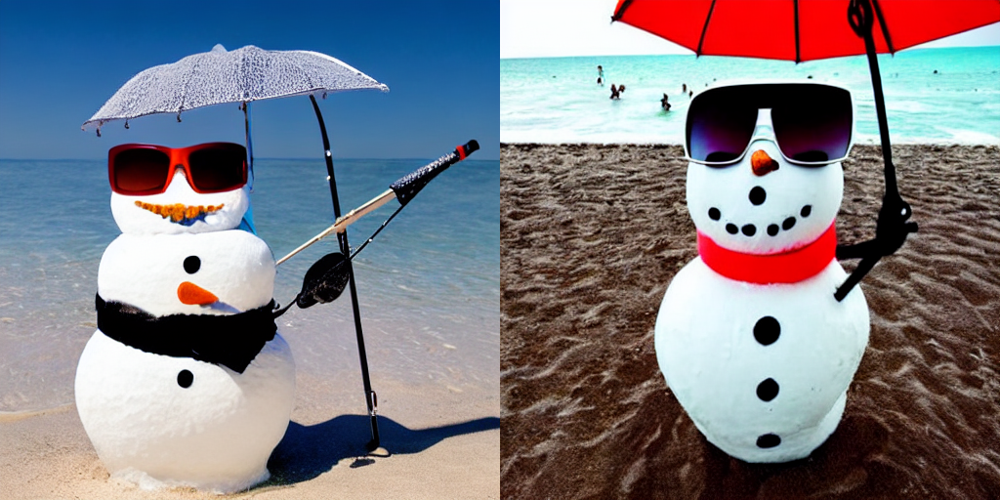

In [30]:
# final comparison
print ('\n----------------------------------------------------------------------------------------------')
print ("Input prompt: ", prompt)
print ('----------------------------------------------------------------------------------------------\n')

print ('With Attend&Excite:')
display(display_alongside_batch(out_attend_and_excite,resize_dims=(512,512)))

print ('----------------------------------------------------------------------------------------------\n')
print ('With Evaluate&Refine:')
display(display_alongside_batch(out_eval_and_refine,resize_dims=(512,512)))

<div class="alert alert-info">
<b>Missing Objects :</b> Since Attend-and-Excite is limited to applying the cross-attention update w.r.t the least dominant subject, as the complexity
of input prompt increases, it may miss some objects (e.g., umbrella) during the generation process. 
In contrast, the iterative nature of our approach allows it to keep refining the output image until a desirable threhold for the overall image-text alignment score is reached.

___

In [38]:
out_attend_and_excite[1].save('output-images/snowman-eval-and-refine-002.png')